In [1]:
import pandas as pd
import json
import ast
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats
from tqdm.notebook import tqdm

In [2]:
df = pd.read_csv("lccollection.csv", delimiter=";")
df

,experiment_id,openmlid,learner,seedindex,cpus,memory_max,time_created,host,executor,time_started,result,exception,time_end
0,1,1485,sklearn.svm.LinearSVC,0,4,8000,2021-10-25 16:44:37,node04-009,oculus-9422697-88,2021-10-25 18:53:07,"[{""traintime"": 0.0228, ""predicttime_train"": 0....",NaN,2021-10-25 18:55:02
1,2,1485,sklearn.tree.DecisionTreeClassifier,0,4,8000,2021-10-25 16:44:37,node04-045,oculus-9422697-237,2021-10-25 18:53:10,"[{""traintime"": 0.0036, ""predicttime_train"": 0....",NaN,2021-10-25 18:53:41
2,3,1590,sklearn.svm.LinearSVC,0,4,8000,2021-10-25 16:44:37,node02-044,oculus-9422697-32,2021-10-25 18:53:03,"[{""traintime"": 0.0043, ""predicttime_train"": 0....",NaN,2021-10-25 18:54:34
3,4,1485,sklearn.tree.ExtraTreeClassifier,0,4,8000,2021-10-25 16:44:37,node06-002,oculus-9422697-396,2021-10-25 18:53:06,"[{""traintime"": 0.0035, ""predicttime_train"": 0....",NaN,2021-10-25 18:53:19
4,5,1590,sklearn.tree.DecisionTreeClassifier,0,4,8000,2021-10-25 16:44:37,node02-014,oculus-9422697-15,2021-10-25 18:53:03,"[{""traintime"": 0.0044, ""predicttime_train"": 0....",NaN,2021-10-25 18:55:01
...,...,...,...,...,...,...,...,...,...,...,...,...,...
11385,11386,1049,sklearn.ensemble.GradientBoostingClassifier,9,4,8000,2021-10-25 21:57:01,node11-020,oculus-9448663-297,2021-10-27 16:08:23,[]\n,NaN,2021-10-27 16:08:26
11386,11387,31,sklearn.ensemble.RandomForestClassifier,9,4,8000,2021-10-25 21:57:01,node05-031,oculus-9448162-143,2021-10-27 16:08:57,"[{""traintime"": 0.1597, ""predicttime_train"": 0....",NaN,2021-10-27 16:09:35
11387,11388,31,sklearn.ensemble.GradientBoostingClassifier,8,4,8000,2021-10-25 21:57:01,node10-002,oculus-9448162-357,2021-10-27 16:08:41,"[{""traintime"": 0.0854, ""predicttime_train"": 0....",NaN,2021-10-27 16:09:01
11388,11389,40975,sklearn.ensemble.GradientBoostingClassifier,9,4,8000,2021-10-25 21:57:01,node04-006,oculus-9448162-29,2021-10-27 16:08:48,"[{""traintime"": 0.0616, ""predicttime_train"": 0....",NaN,2021-10-27 16:10:00


In [3]:
def flatten_results(df):
    rows = []
    fields = ['seed', 'size_train', 'size_test', 'traintime', 'predicttime_train', 'predicttimeproba_train', 'predicttime_test', 'predicttimeproba_test', 'accuracy_train', 'accuracy_test']
    pbar = tqdm(total=len(df))
    for i, df_row in df.iterrows():
        if pd.notna(df_row["result"]):
            result = ast.literal_eval(df_row["result"])
            for entry in result:
                row = [df_row["openmlid"], df_row["learner"]]
                row.extend([entry[f] for f in fields])
                rows.append(row)
        pbar.update(1)
    pbar.close()
    cols = ["openmlid", "learner"] + fields
    return pd.DataFrame(rows, columns=cols)

dfResults = flatten_results(df)
dfResults

  0%|          | 0/11390 [00:00<?, ?it/s]

,openmlid,learner,seed,size_train,size_test,traintime,predicttime_train,predicttimeproba_train,predicttime_test,predicttimeproba_test,accuracy_train,accuracy_test
0,1485,sklearn.svm.LinearSVC,0,16,2584,0.0228,0.0002,0.0000,0.0013,0.0000,1.0000,0.4745
1,1485,sklearn.svm.LinearSVC,0,23,2577,0.0258,0.0002,0.0000,0.0014,0.0000,1.0000,0.5130
2,1485,sklearn.svm.LinearSVC,0,32,2568,0.0357,0.0002,0.0000,0.0013,0.0000,1.0000,0.5366
3,1485,sklearn.svm.LinearSVC,0,45,2555,0.0496,0.0002,0.0000,0.0012,0.0000,1.0000,0.5276
4,1485,sklearn.svm.LinearSVC,0,64,2536,0.0694,0.0002,0.0000,0.0012,0.0000,0.9844,0.5422
...,...,...,...,...,...,...,...,...,...,...,...,...
1677373,31,sklearn.ensemble.GradientBoostingClassifier,99,181,819,0.1111,0.0010,0.0009,0.0023,0.0022,0.9834,0.6728
1677374,31,sklearn.ensemble.GradientBoostingClassifier,99,256,744,0.1190,0.0012,0.0010,0.0022,0.0021,0.9570,0.7164
1677375,31,sklearn.ensemble.GradientBoostingClassifier,99,362,638,0.1281,0.0014,0.0012,0.0020,0.0018,0.9254,0.6865
1677376,31,sklearn.ensemble.GradientBoostingClassifier,99,512,488,0.1499,0.0020,0.0018,0.0017,0.0017,0.9004,0.7070


In [4]:
dfResults.to_csv("empiricalcurves.csv", index=False)

In [5]:
dfResults = pd.read_csv("empiricalcurves.csv")

In [6]:
dfResults.query("learner == 'sklearn.svm.LinearSVC' and openmlid == 3")

,openmlid,learner,seed,size_train,size_test,traintime,predicttime_train,predicttimeproba_train,predicttime_test,predicttimeproba_test,accuracy_train,accuracy_test
140846,3,sklearn.svm.LinearSVC,0,16,3180,0.0064,0.0005,0.0,0.0024,0.0,1.0000,0.7374
140847,3,sklearn.svm.LinearSVC,0,23,3173,0.0025,0.0004,0.0,0.0018,0.0,1.0000,0.7239
140848,3,sklearn.svm.LinearSVC,0,32,3164,0.0035,0.0004,0.0,0.0017,0.0,1.0000,0.8824
140849,3,sklearn.svm.LinearSVC,0,45,3151,0.0031,0.0004,0.0,0.0017,0.0,1.0000,0.8648
140850,3,sklearn.svm.LinearSVC,0,64,3132,0.0040,0.0004,0.0,0.0017,0.0,1.0000,0.8777
...,...,...,...,...,...,...,...,...,...,...,...,...
1490877,3,sklearn.svm.LinearSVC,99,724,2472,0.0214,0.0010,0.0,0.0018,0.0,0.9724,0.9652
1490878,3,sklearn.svm.LinearSVC,99,1024,2172,0.0278,0.0013,0.0,0.0015,0.0,0.9756,0.9669
1490879,3,sklearn.svm.LinearSVC,99,1448,1748,0.0398,0.0016,0.0,0.0012,0.0,0.9758,0.9680
1490880,3,sklearn.svm.LinearSVC,99,2048,1148,0.0574,0.0019,0.0,0.0009,0.0,0.9756,0.9625


In [7]:
learners = list(pd.unique(dfResults["learner"]))
datasets = list(pd.unique(dfResults["openmlid"]))

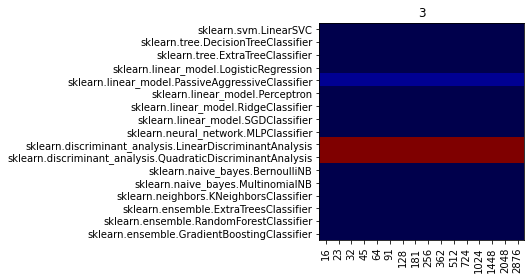

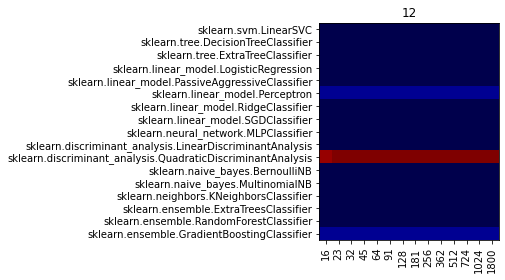

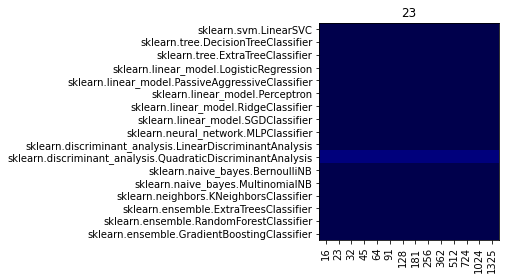

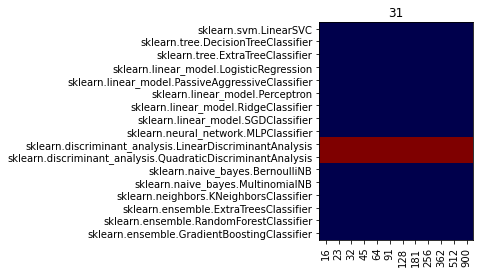

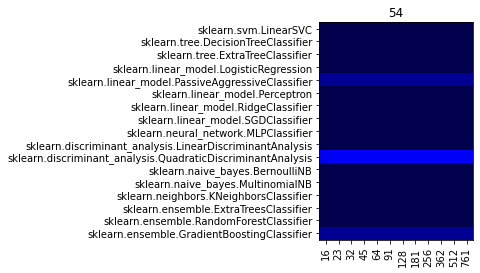

...

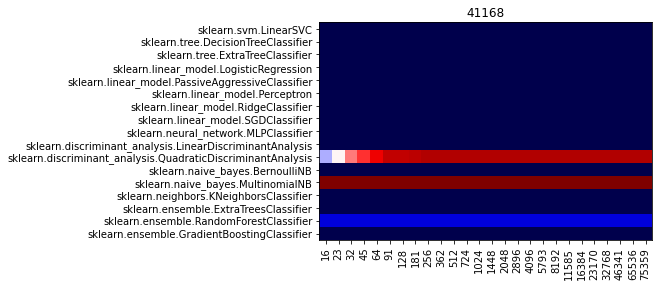

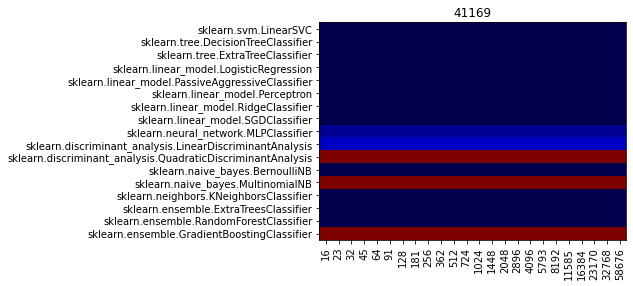

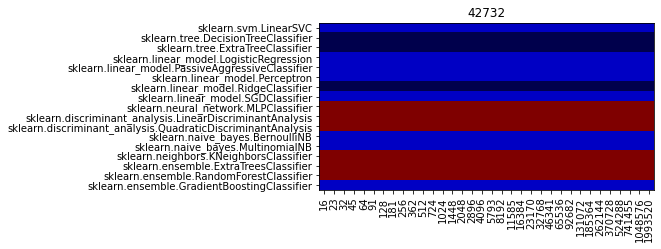

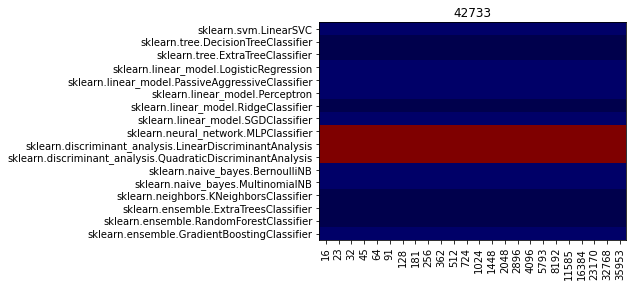

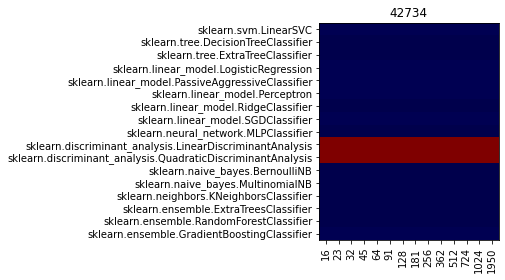

In [16]:
for openmlid, dfDataset in dfResults.groupby("openmlid"):
    anchors = sorted(list(pd.unique(dfDataset["size_train"])))
    Z = np.zeros((len(learners), len(anchors)))
    for i, learner in enumerate(learners):
        for j, anchor in enumerate(anchors):
            Z[i,j] = np.count_nonzero((dfDataset["learner"] == learner) & (dfDataset["size_train"] == anchor))
            #if Z[i,j] == 0:
                #print(learner, openmlid)
    fig, ax = plt.subplots()
    ax.imshow(-Z, cmap="seismic", vmin = -100, vmax = 0)
    ax.set_yticks(range(len(learners)))
    ax.set_yticklabels(learners)
    ax.set_xticks(range(len(anchors)))
    ax.set_xticklabels(anchors, rotation=90)
    ax.set_title(openmlid)
    plt.show()

In [48]:
def get_grouped_curve(anchors, obs):
    anchors_sorted = sorted(list(np.unique(anchors)))
    out = []
    min_obs = np.inf
    for anchor in anchors_sorted:
        sub_obs = list(obs[anchors == anchor])
        min_obs = min(min_obs, len(sub_obs))
        out.append(sub_obs)
    return anchors_sorted, np.array([e[:min_obs] for e in out])

def get_train_curve(df, learner, openmlid, metric):
    dfSub = df[(df["learner"] == learner) & (df["openmlid"] == openmlid)]
    return get_grouped_curve(dfSub["size_train"].values, dfSub[metric + "_train"].values)

def get_test_curve(df, learner, openmlid, metric):
    dfSub = df[(df["learner"] == learner) & (df["openmlid"] == openmlid)]
    return get_grouped_curve(dfSub["size_train"].values, dfSub[metric + "_test"].values)

def get_traintime_curve(df, learner, openmlid):
    dfSub = df[(df["learner"] == learner) & (df["openmlid"] == openmlid)]
    return get_grouped_curve(dfSub["size_train"].values, dfSub["traintime"].values)

0it [00:00, ?it/s]

/home/felix/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  


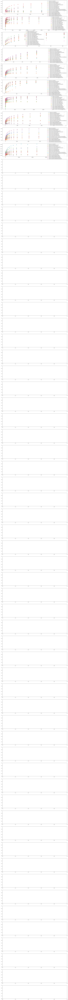

In [18]:
fig, ax = plt.subplots(len(datasets), 1, figsize=(20, len(datasets) * 5))
for i, openmlid in tqdm(enumerate(datasets[:10])):
    for j, learner in enumerate(learners):
        #x, y = get_train_curve(dfResults, learner, openmlid, "accuracy")
        x, y = get_test_curve(dfResults, learner, openmlid, "accuracy")
        if len(y) > 0 and len(y.shape) == 2:
            #ax[i].plot(x, np.mean(y, axis=1), label="train")
            ax[i].scatter(x, np.mean(y, axis=1), label=learner, color="C" + str(learners.index(learner)))
        ax[i].legend()
        #ax.set_title(learner)
plt.show()

In [11]:
Z = np.zeros((len(learners), len(learners)))
for openmlid, dfDataset in dfResults.groupby("openmlid"):
    for i, learner1 in enumerate(learners):
        x1, y1 = get_test_curve(dfDataset, learner1, openmlid, "accuracy")
        if len(y1.shape) != 2:
            continue
        for j, learner2 in enumerate(learners):
            if j >= i:
                Z[i,j] = np.nan
                break
            x2, y2 = get_test_curve(dfDataset, learner2, openmlid, "accuracy")
            if len(y2.shape) != 2:
                continue
            if len(x1) != len(x2):
                break
            comparison = np.mean(y1, axis=1) >= np.mean(y2, axis=1)
            wins1 = np.count_nonzero(comparison)
            wins2 = len(comparison) - wins1
            Z[i,j] += (comparison[0] != comparison[-1])

/home/felix/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  


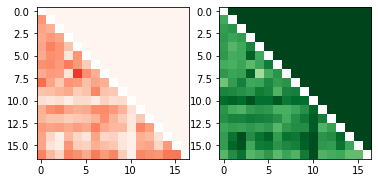

In [12]:
fig, ax = plt.subplots(1, 2)
ax[0].imshow(Z, cmap="Reds", vmin=0, vmax=63)
ax[1].imshow(-Z, cmap="Greens", vmin=-63, vmax=0)
ax
plt.show()

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 12


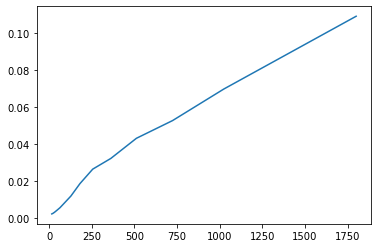

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 23


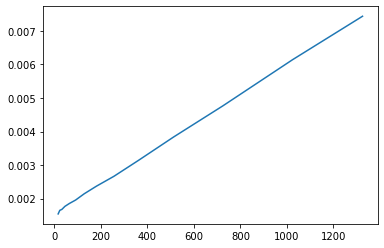

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 54


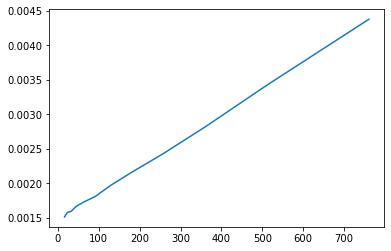

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 181


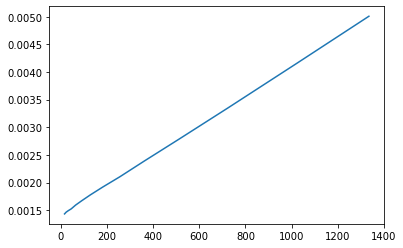

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 1457


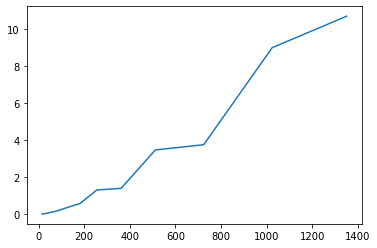

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 1464


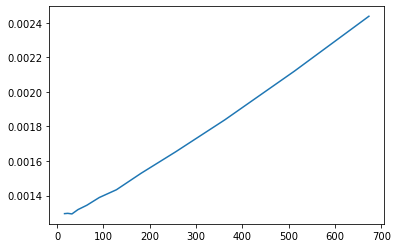

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 1468


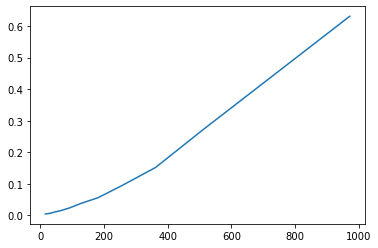

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 1475


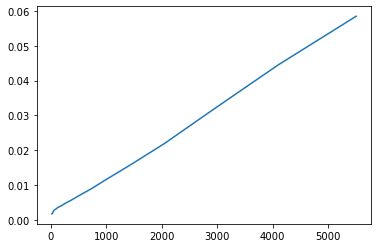

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 1485


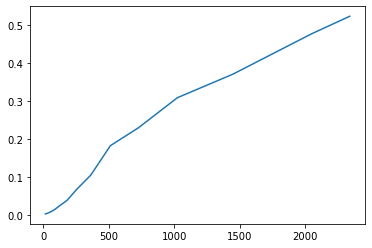

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 1487


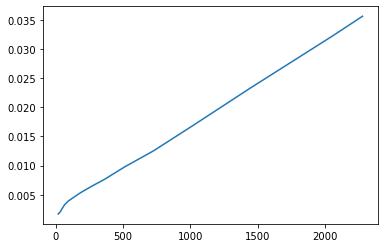

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 1489


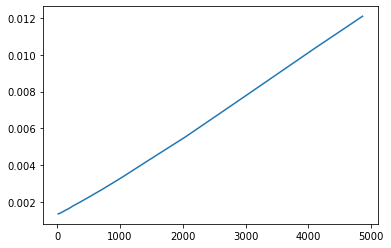

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 1494


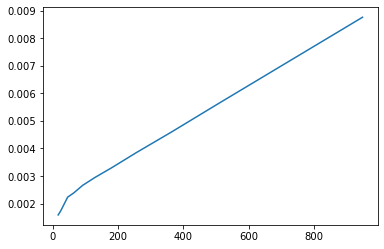

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 1515


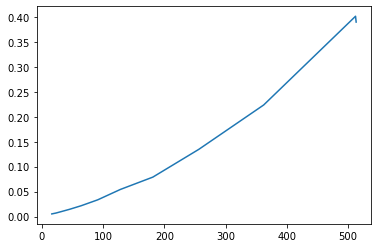

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 4134


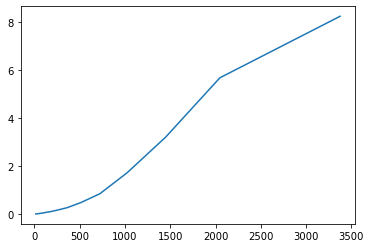

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 4538


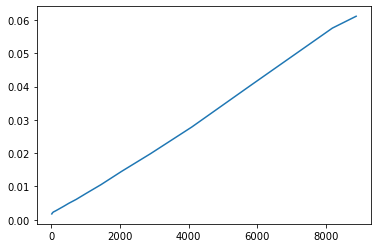

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 23512


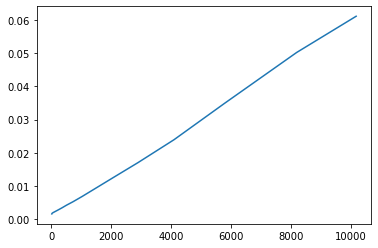

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 23517


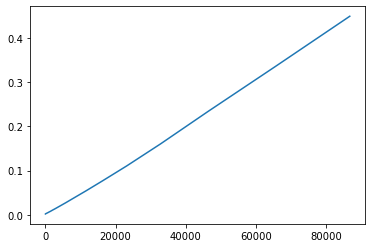

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 40498


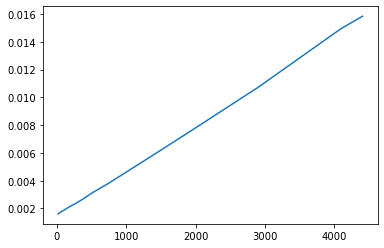

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 40685


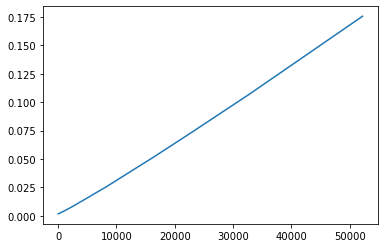

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 40701


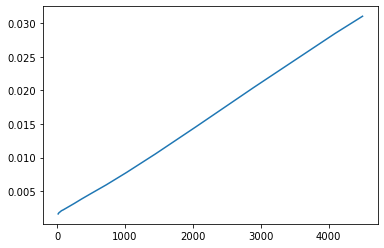

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 40900


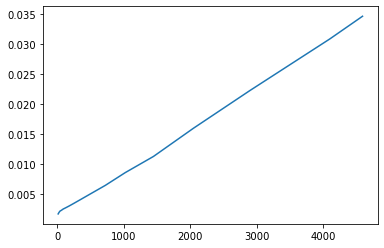

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 40975


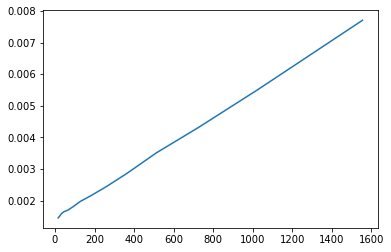

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 40981


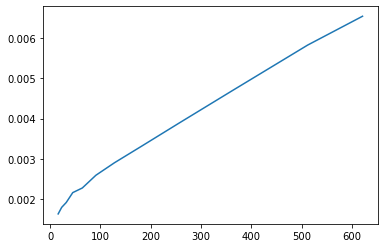

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 40982


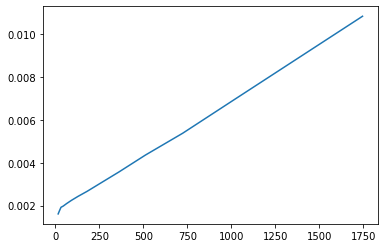

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 40983


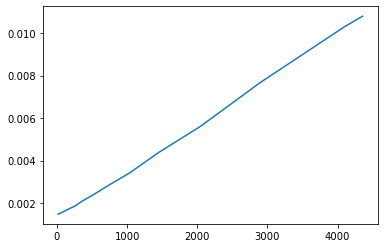

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 40984


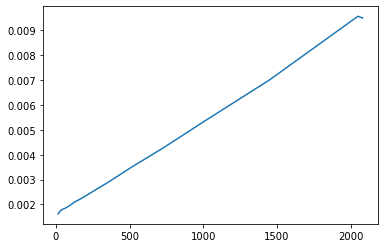

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 40996


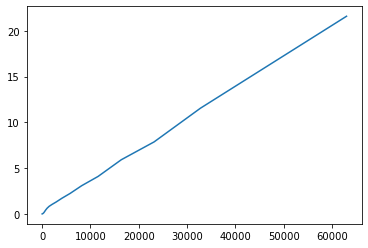

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 41027


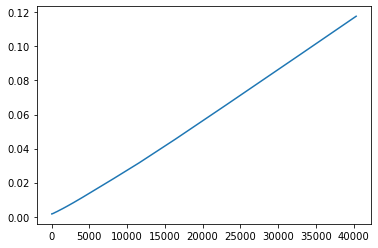

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 41138


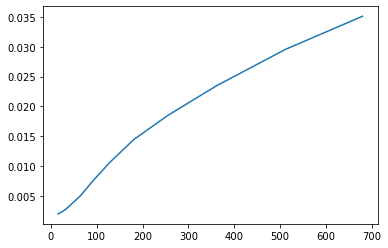

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 41142


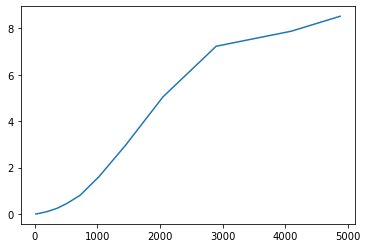

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 41144


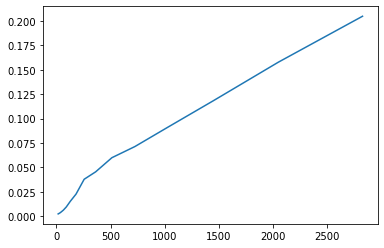

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 41145


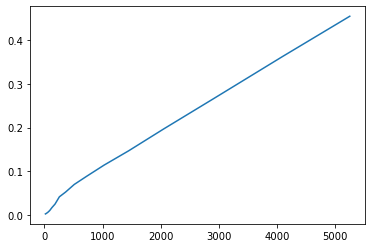

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 41146


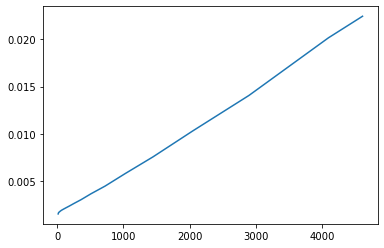

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 41156


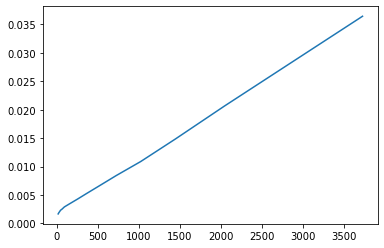

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 41157


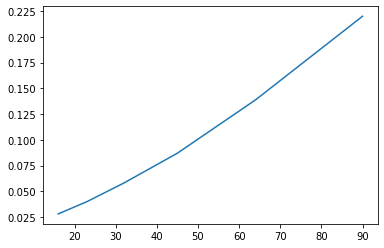

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 41158


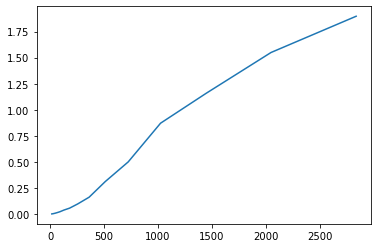

sklearn.discriminant_analysis.LinearDiscriminantAnalysis 41159


/home/felix/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  


IndexError: tuple index out of range

In [13]:
for (learner, openmlid), dfResultsLearner in dfResults.groupby(["learner", "openmlid"]):
    x, y= get_traintime_curve(dfResultsLearner, learner, openmlid)
    print(learner, openmlid)
    plt.plot(x, scipy.stats.trim_mean(y, 0.2, axis=1))
    plt.show()

# Train Vs Test Curve

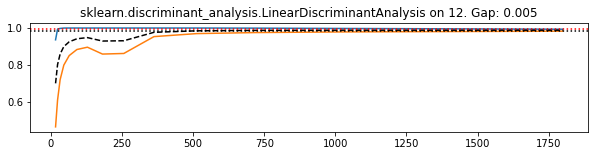

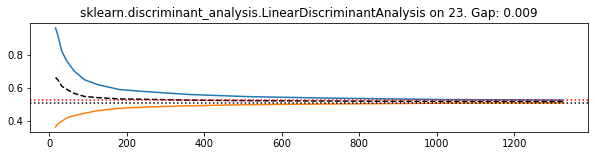

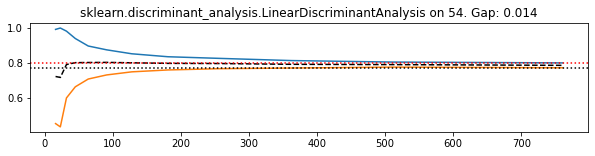

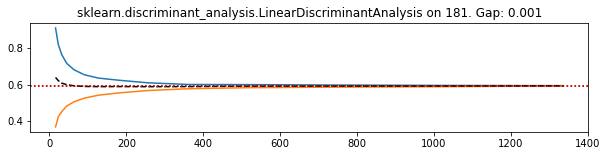

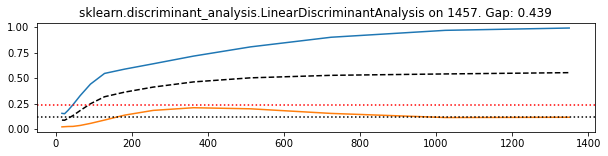

...

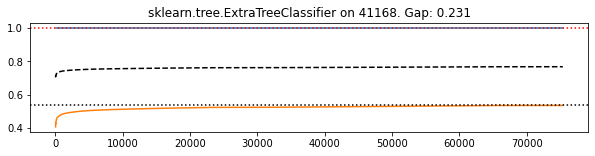

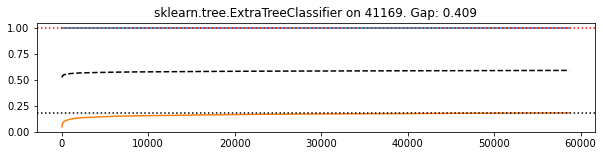

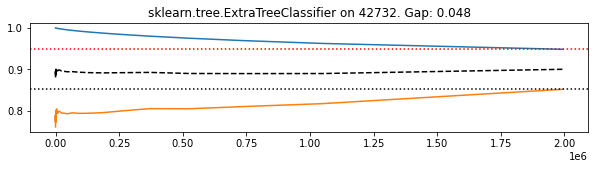

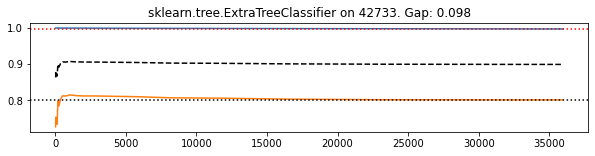

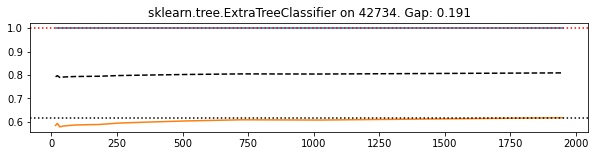

In [53]:
for (learner, openmlid), dfResultsLearner in dfResults.groupby(["learner", "openmlid"]):
    if len(dfResultsLearner) < 100:
        continue
    #print(len(dfResultsLearner))
    fig, ax = plt.subplots(figsize=(10, 2))
    x, y_train = get_train_curve(dfResultsLearner, learner, openmlid, "accuracy")
    ax.plot(x, np.mean(y_train, axis=1))
    x, y_test = get_test_curve(dfResultsLearner, learner, openmlid, "accuracy")
    ax.plot(x, np.mean(y_test, axis=1))
    y_estimate = np.mean((y_train + y_test) / 2, axis=1)
    ax.plot(x, y_estimate, linestyle="--", color="black")
    y_final = np.mean(y_test[-1])
    ax.axhline(y_final, linestyle="dotted", color="black")
    ax.axhline(np.min(np.mean(y_train[3:], axis=1)), linestyle="dotted", color="red")
    ax.set_title(f"{learner} on {openmlid}. Gap: {np.round(y_estimate[-1] - y_final, 3)}")
    plt.show()